In [1]:
using ComplexSystems, LightGraphs, DelimitedFiles, Plots

# All pairs interactions

## Parameters
new infections -> $\beta$

re-susceptibles from infected -> $\alpha$

recovered -> $\gamma$

re-susceptibles from recovered -> $\alpha$

deceased -> $\mu$

exposed -> $\epsilon$

In [2]:
function degree_dist(p,k_max)
    pk = zeros(k_max)
    for k in 0:(k_max-1)
        pk[k+1] = p*(1-p)^k
    end
    pk
end

function degree_dist(p,k_max)
    pk = zeros(k_max)
    for k in 0:(k_max-1)
        pk[k+1] = (1-exp(-p))*exp(-p*k)
    end
    pk
end

function all_but_me(x,i)
    y = copy(x)
    sum(deleteat!(y,i))
end

function SI(x;β)
    y = zeros(length(x))
    y[1] = -β*x[1]*x[2]/sum(x)
    y[2] = β*x[2]*(1-(x[2]/sum(x)))
    y
end

function SIS(x;α,β)
    y = zeros(length(x))
    infected_k = β*x[1]*x[2]/sum(x)
    susceptible_k = α*x[2]
    y[1] = -infected_k + susceptible_k
    y[2] = infected_k - susceptible_k
    y
end

function SIR(x;β,γ)
    y = zeros(length(x))
    susceptible_k = -β*x[1]*x[2]/sum(x)
    infected_k = β*x[1]*x[2]/sum(x) - γ*x[2]
    recovered_k = γ*x[2]
    y[1] = susceptible_k - infected_k
    y[2] = infected_k - susceptible_k - recovered_k
    y[3] = recovered_k
    y
end

function SIRS(x;β,γ,α)
    y = zeros(length(x))
    susceptible_k = -β*x[1]*x[2]/sum(x) + α*x[3]
    infected_k = β*x[1]*x[2]/sum(x) - γ*x[2]
    recovered_k = γ*x[2] - α*x[3]
    y[1] = susceptible_k - infected_k
    y[2] = infected_k - susceptible_k - recovered_k
    y[3] = recovered_k
    y
end


function SIRSD(x;β,γ,α,μ)
    y = zeros(length(x))
    susceptible_k = -β*x[1]*x[2]/sum(x) + α*x[3]
    infected_k = β*x[1]*x[2]/sum(x) - γ*x[2] - μ*x[2]
    recovered_k = γ*x[2] - α*x[3]
    dead_k = μ*x[2]
    y[1] = susceptible_k - infected_k
    y[2] = infected_k - susceptible_k - recovered_k - dead_k
    y[3] = recovered_k
    y[4] = dead_k
    y
end

function SEIS(x;β,γ,ϵ,a)
    y = zeros(length(x))
    susceptible_k = -β*x[1]*x[2]/sum(x)
    exposed_k = β*x[1]*x[2]/sum(x) - (ϵ+a)*x[3]
    infected_k = ϵ*x[3] - (γ+a)*x[2]
    y[1] = susceptible_k - infected_k - exposed_k
    y[2] = infected_k - susceptible_k - exposed_k
    y[3] = exposed_k
    y
end

function SEIRS(x;β,γ,ϵ,α,a)
    y = zeros(length(x))
    susceptible_k = -β*x[1]*x[2]/sum(x) + α*x[3]
    exposed_k = β*x[1]*x[2]/sum(x) - (ϵ+a)*x[4]
    infected_k = ϵ*x[4] - (γ+a)*x[2]
    recovered_k = γ*x[2] - α*x[3]
    y[1] = susceptible_k - infected_k - exposed_k - recovered_k
    y[2] = infected_k - susceptible_k - exposed_k
    y[3] = recovered_k
    y[4] = exposed_k
    y
end

SEIRS (generic function with 1 method)

# Homogeneous mean field models

# Simple SI model

In [3]:
t1,y1 = my_integrator(0,100,0.1,[0.99,0.01,0];fun=SI,algo=heun,β=0.1)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  99.1, 99.2, 99.3, 99.4, 99.5, 99.6, 99.7, 99.8, 99.9, 100.0], [0.99 0.01 0.0; 0.989901 0.0100995 0.0; … ; 0.00451978 0.99548 0.0; 0.00447501 0.995525 0.0])

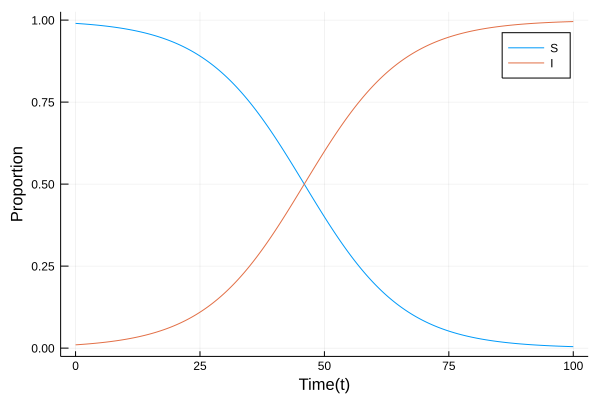

In [4]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")

# Simple SIS model

In [5]:
t1,y1 = my_integrator(0,100,0.1,[0.99,0.01];fun=SIS,algo=heun,α = 0.3, β=0.9)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  99.1, 99.2, 99.3, 99.4, 99.5, 99.6, 99.7, 99.8, 99.9, 100.0], [0.99 0.01; 0.989392 0.0106082; … ; 0.333333 0.666667; 0.333333 0.666667])

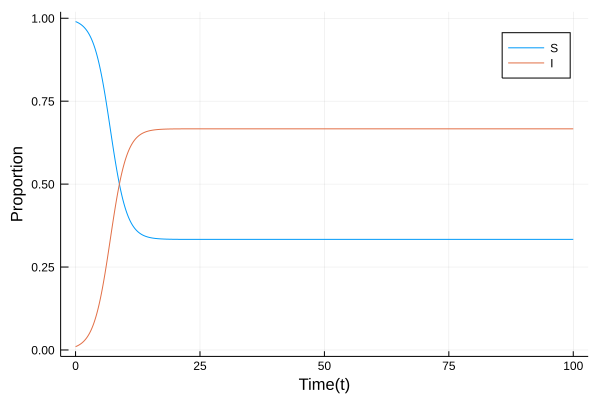

In [6]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")

# Simple SIR model

In [7]:
t1,y1 = my_integrator(0,100,0.1,[0.7,0.3,0];fun=SIR,algo=heun,β=0.2,γ = 0.07)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  99.1, 99.2, 99.3, 99.4, 99.5, 99.6, 99.7, 99.8, 99.9, 100.0], [0.7 0.3 0.0; 0.693694 0.304191 0.0021147; … ; 0.179875 0.00123229 0.818893; 0.179875 0.00122393 0.818901])

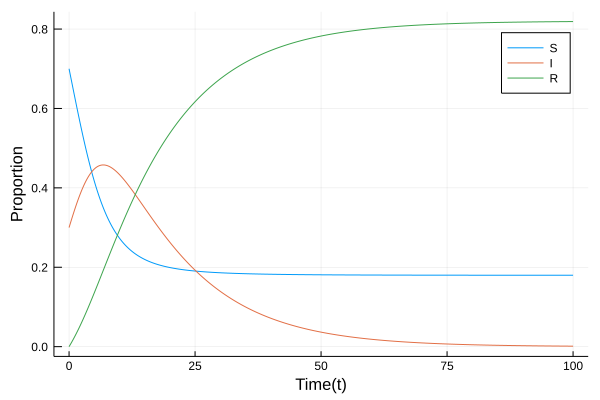

In [8]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")
Plots.plot!(t1,y1[:,3],label="R")

# Simple SIRS model

In [9]:
t1,y1 = my_integrator(0,200,0.1,[0.7,0.3,0];fun=SIRS,algo=heun,β=0.4,γ = 0.07,α = 0.02)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  199.1, 199.2, 199.3, 199.4, 199.5, 199.6, 199.7, 199.8, 199.9, 200.0], [0.7 0.3 0.0; 0.685177 0.312681 0.002142; … ; 0.175 0.183333 0.641667; 0.175 0.183333 0.641667])

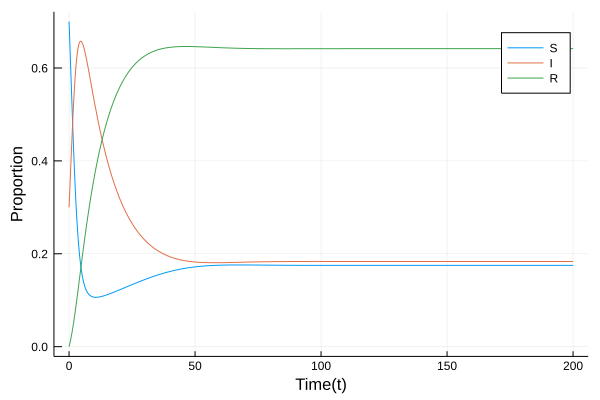

In [10]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")
Plots.plot!(t1,y1[:,3],label="R")

# SIRSD (deceased)

In [11]:
t1,y1 = my_integrator(0,200,0.1,[0.7,0.3,0,0];fun=SIRSD,algo=heun,β=0.1,γ = 0.02, α = 0.02, μ = 0.02)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  199.1, 199.2, 199.3, 199.4, 199.5, 199.6, 199.7, 199.8, 199.9, 200.0], [0.7 0.3 0.0 0.0; 0.697001 0.301796 0.0006012 0.0006018; … ; 0.3675 0.0316936 0.055466 0.54534; 0.367505 0.031673 0.0554185 0.545403])

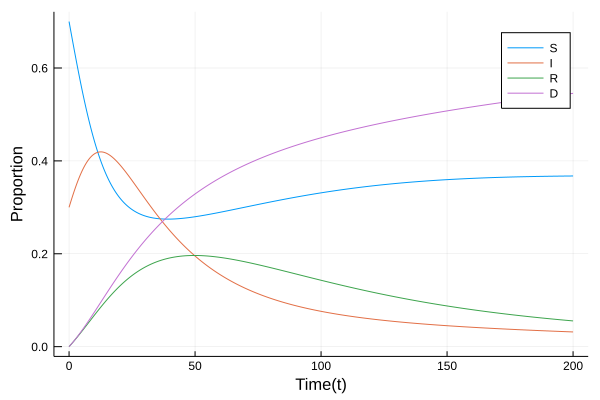

In [12]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")
Plots.plot!(t1,y1[:,3],label="R")
Plots.plot!(t1,y1[:,4],label="D")

# SEIS

In [13]:
t1,y1 = my_integrator(0,500,0.1,[0.9,0.1,0];fun=SEIS,algo=heun,β=0.3,γ = 0.02,ϵ = 0.2,a=0.1)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  499.1, 499.2, 499.3, 499.4, 499.5, 499.6, 499.7, 499.8, 499.9, 500.0], [0.9 0.1 0.0; 0.895844 0.0988747 0.00264067; … ; 0.209224 0.534308 0.128234; 0.209224 0.534308 0.128234])

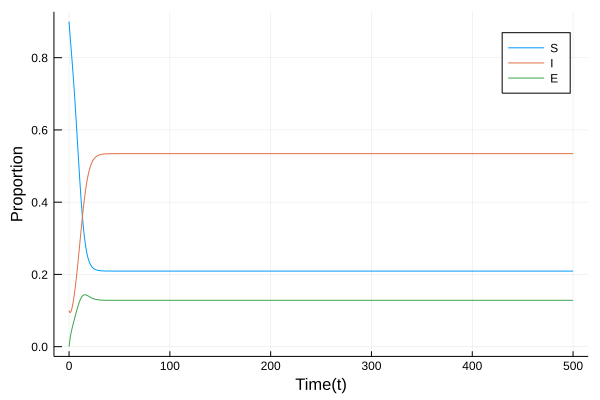

In [14]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")
Plots.plot!(t1,y1[:,3],label="E")

# SEIRS

In [15]:
t1,y1 = my_integrator(0,700,0.1,[0.7,0.3,0,0];fun=SEIRS,algo=heun,β=0.05,γ = 0.02,ϵ = 0.03,α=0.01,a=0.01)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  699.1, 699.2, 699.3, 699.4, 699.5, 699.6, 699.7, 699.8, 699.9, 700.0], [0.7 0.3 0.0 0.0; 0.698205 0.299105 0.0005988 0.00104553; … ; 0.532789 0.10188 0.217534 0.0738987; 0.532813 0.101874 0.217521 0.0738962])

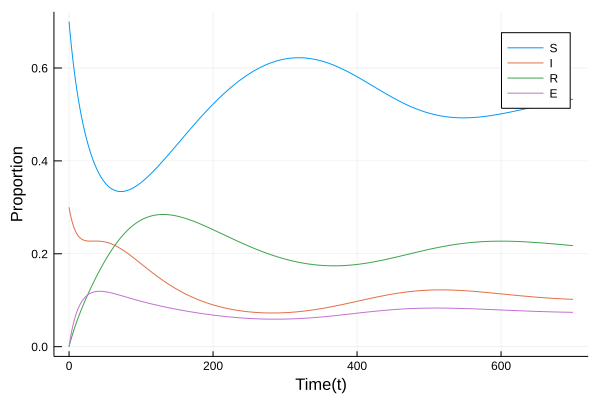

In [16]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")
Plots.plot!(t1,y1[:,3],label="R")
Plots.plot!(t1,y1[:,4],label="E")

# Erdos-Renyi

In [17]:
function degree_dist(p,k_max)
    pk = zeros(k_max)
    for k in 0:(k_max-1)
        pk[k+1] = p*(1-p)^k
    end
    pk
end

function SI(x;β,p)
    y = zeros(length(x))
    y[1] = -β*p*x[1]*x[2]/sum(x)
    y[2] = β*p*x[2]*(1-(x[2]/sum(x)))
    y
end

function SIS(x;α,β,p)
    y = zeros(length(x))
    infected_k = β*p*x[1]*x[2]/sum(x)
    susceptible_k = α*x[2]
    y[1] = -infected_k + susceptible_k
    y[2] = infected_k - susceptible_k
    y
end

function SIR(x;β,γ,p)
    y = zeros(length(x))
    susceptible_k = -β*x[1]*x[2]/sum(x)
    infected_k = β*p*x[1]*x[2]/sum(x) - γ*x[2]
    recovered_k = γ*x[2]
    y[1] = susceptible_k - infected_k
    y[2] = infected_k - susceptible_k - recovered_k
    y[3] = recovered_k
    y
end

function SIRS(x;β,γ,α,p)
    y = zeros(length(x))
    susceptible_k = -β*x[1]*x[2]/sum(x) + α*x[3]
    infected_k = β*p*x[1]*x[2]/sum(x) - γ*x[2]
    recovered_k = γ*x[2] - α*x[3]
    y[1] = susceptible_k - infected_k
    y[2] = infected_k - susceptible_k - recovered_k
    y[3] = recovered_k
    y
end


function SIRSD(x;β,γ,α,μ,p)
    y = zeros(length(x))
    susceptible_k = -β*x[1]*x[2]/sum(x) + α*x[3]
    infected_k = β*p*x[1]*x[2]/sum(x) - γ*x[2] - μ*x[2]
    recovered_k = γ*x[2] - α*x[3]
    dead_k = μ*x[2]
    y[1] = susceptible_k - infected_k
    y[2] = infected_k - susceptible_k - recovered_k - dead_k
    y[3] = recovered_k
    y[4] = dead_k
    y
end

function SEIS(x;β,γ,ϵ,a,p)
    y = zeros(length(x))
    susceptible_k = -β*x[1]*x[2]/sum(x)
    exposed_k = β*p*x[1]*x[2]/sum(x) - (ϵ+a)*x[3]
    infected_k = ϵ*x[3] - (γ+a)*x[2]
    y[1] = susceptible_k - infected_k - exposed_k
    y[2] = infected_k - susceptible_k - exposed_k
    y[3] = exposed_k
    y
end

function SEIRS(x;β,γ,ϵ,α,a,p)
    y = zeros(length(x))
    susceptible_k = -β*x[1]*x[2]/sum(x) + α*x[3]
    exposed_k = β*x[1]*x[2]/sum(x) - (ϵ+a)*x[4]
    infected_k = ϵ*p*x[4] - (γ+a)*x[2]
    recovered_k = γ*x[2] - α*x[3]
    y[1] = susceptible_k - infected_k - exposed_k - recovered_k
    y[2] = infected_k - susceptible_k - exposed_k
    y[3] = recovered_k
    y[4] = exposed_k
    y
end

SEIRS (generic function with 1 method)

In [18]:
t1,y1 = my_integrator(0,100,0.1,[0.99,0.01,0];fun=SI,algo=heun,β=0.2,p=0.7)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  99.1, 99.2, 99.3, 99.4, 99.5, 99.6, 99.7, 99.8, 99.9, 100.0], [0.99 0.01 0.0; 0.98986 0.0101396 0.0; … ; 8.35052e-5 0.999916 0.0; 8.23444e-5 0.999918 0.0])

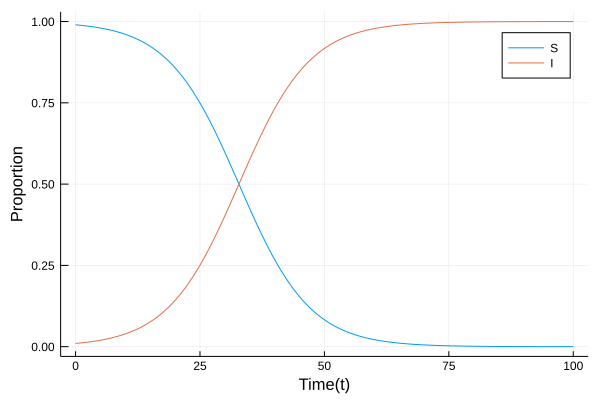

In [19]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")

In [20]:
t1,y1 = my_integrator(0,100,0.1,[0.99,0.01,0];fun=SI,algo=heun,β=0.2,p=0.5)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  99.1, 99.2, 99.3, 99.4, 99.5, 99.6, 99.7, 99.8, 99.9, 100.0], [0.99 0.01 0.0; 0.989901 0.0100995 0.0; … ; 0.00451978 0.99548 0.0; 0.00447501 0.995525 0.0])

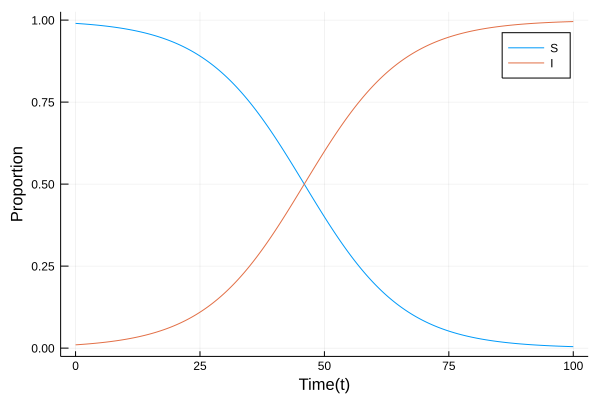

In [21]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")

In [22]:
t1,y1 = my_integrator(0,100,0.1,[0.99,0.01];fun=SIS,algo=heun,α = 0.1, β=0.6, p=0.3)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  99.1, 99.2, 99.3, 99.4, 99.5, 99.6, 99.7, 99.8, 99.9, 100.0], [0.99 0.01; 0.989922 0.0100785; … ; 0.561991 0.438009; 0.56194 0.43806])

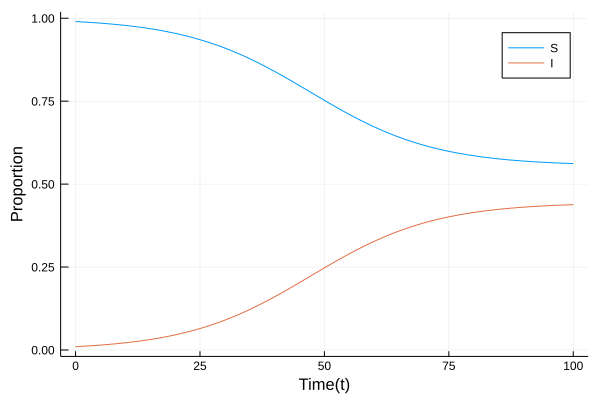

In [23]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")

In [24]:
t1,y1 = my_integrator(0,100,0.1,[0.7,0.3,0];fun=SIR,algo=heun,β=0.2,γ = 0.07,p=1)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  99.1, 99.2, 99.3, 99.4, 99.5, 99.6, 99.7, 99.8, 99.9, 100.0], [0.7 0.3 0.0; 0.693694 0.304191 0.0021147; … ; 0.179875 0.00123229 0.818893; 0.179875 0.00122393 0.818901])

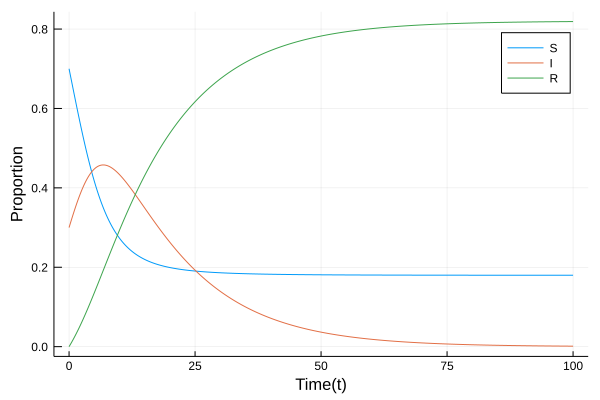

In [25]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")
Plots.plot!(t1,y1[:,3],label="R")

In [26]:
t1,y1 = my_integrator(0,100,0.1,[0.999,0.001,0];fun=SIR,algo=heun,β=1,γ = 0.1,p=0.3)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  99.1, 99.2, 99.3, 99.4, 99.5, 99.6, 99.7, 99.8, 99.9, 100.0], [0.999 0.001 0.0; 0.998874 0.0011159 1.05494e-5; … ; 0.0769288 8.0311e-5 0.922991; 0.0769288 7.95119e-5 0.922992])

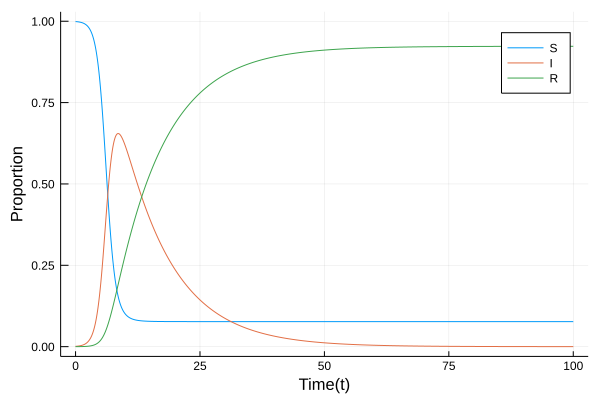

In [27]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")
Plots.plot!(t1,y1[:,3],label="R")

In [28]:
t1,y1 = my_integrator(0,200,0.1,[0.999,0.001,0];fun=SIRS,algo=heun,β=1,γ = 0.1,α = 0.0001,p=0.1)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  199.1, 199.2, 199.3, 199.4, 199.5, 199.6, 199.7, 199.8, 199.9, 200.0], [0.999 0.001 0.0; 0.998896 0.00109392 1.04494e-5; … ; 0.105551 1.5779e-8 0.894449; 0.10556 1.56471e-8 0.89444])

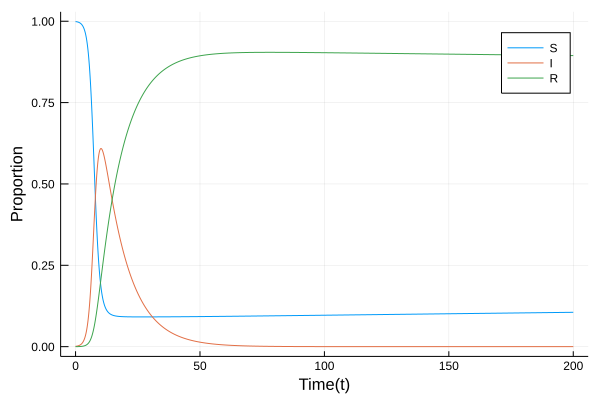

In [29]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")
Plots.plot!(t1,y1[:,3],label="R")

In [30]:
t1,y1 = my_integrator(0,200,0.1,[0.7,0.3,0];fun=SIRS,algo=heun,β=0.3,γ = 0.07,α = 0.02,p=0.1)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  199.1, 199.2, 199.3, 199.4, 199.5, 199.6, 199.7, 199.8, 199.9, 200.0], [0.7 0.3 0.0; 0.695174 0.302718 0.00210746; … ; 0.424624 0.12759 0.447786; 0.424625 0.127592 0.447783])

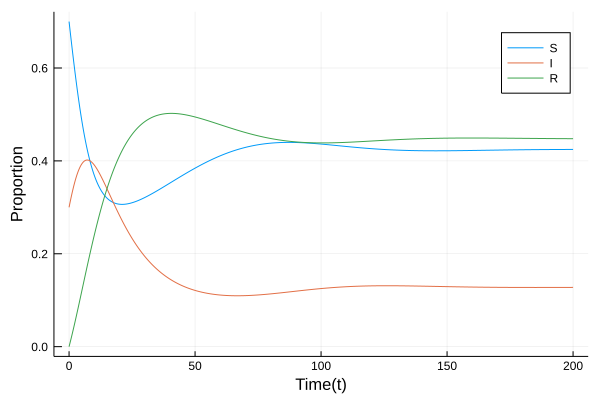

In [31]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")
Plots.plot!(t1,y1[:,3],label="R")

In [32]:
t1,y1 = my_integrator(0,200,0.1,[0.7,0.3,0,0];fun=SIRSD,algo=heun,β=0.1,γ = 0.02, α = 0.02, μ = 0.001,p=1)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  199.1, 199.2, 199.3, 199.4, 199.5, 199.6, 199.7, 199.8, 199.9, 200.0], [0.7 0.3 0.0 0.0; 0.696424 0.302944 0.00060234 3.0147e-5; … ; 0.20759 0.350216 0.359165 0.083029; 0.20759 0.350199 0.359148 0.083064])

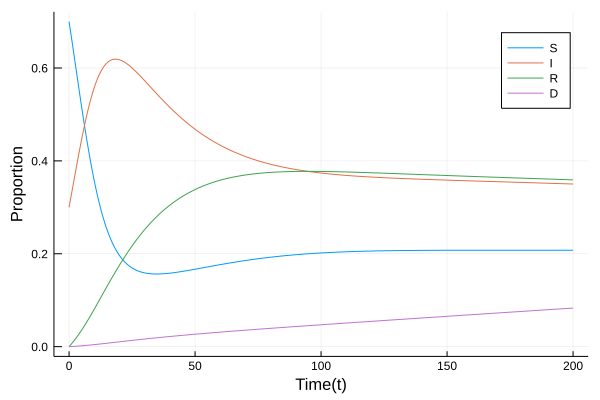

In [33]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")
Plots.plot!(t1,y1[:,3],label="R")
Plots.plot!(t1,y1[:,4],label="D")

In [34]:
t1,y1 = my_integrator(0,200,0.1,[0.7,0.3,0,0];fun=SIRSD,algo=heun,β=0.1,γ = 0.02, α = 0.02, μ = 0.001,p=0.2)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  199.1, 199.2, 199.3, 199.4, 199.5, 199.6, 199.7, 199.8, 199.9, 200.0], [0.7 0.3 0.0 0.0; 0.69811 0.301259 0.00060066 3.0063e-5; … ; 0.347159 0.287867 0.296171 0.0688036; 0.347156 0.287857 0.296154 0.0688324])

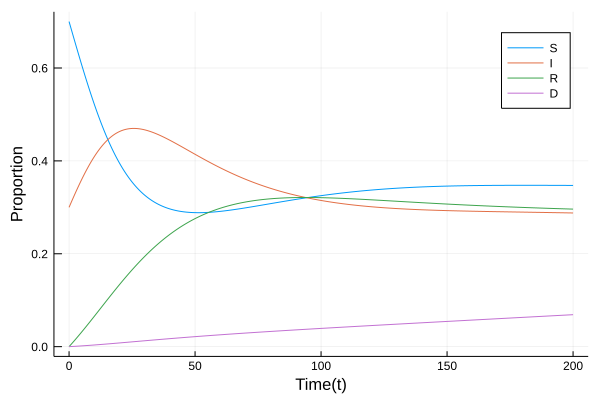

In [35]:
p1=Plots.plot(t1,y1[:,1],label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,y1[:,2],label="I")
Plots.plot!(t1,y1[:,3],label="R")
Plots.plot!(t1,y1[:,4],label="D")

# Heterogeneous mean-fild no change

In [3]:
function SIS_configuration(x;α,β,k_max,prop_deg)
    y = zeros(length(x))
    x = x[1:k_max]
    avg_k = collect(1:k_max) .* x |> sum
    further = collect(1:k_max) .* prop_deg .* x |> sum
    θ = further/avg_k
    for k in 1:k_max
        infected_k = β*k*(1-x[k])*θ - α*x[k]
        susceptible_k = α*x[k]
        y[k] = infected_k - susceptible_k
        y[k+k_max] = susceptible_k - infected_k
    end
    y
end

SIS_configuration (generic function with 1 method)

In [4]:
kmax = 100
infec = rand(kmax)
all = sum(infec)
prop_inf = infec/all;

In [5]:
pd = degree_dist(0.1,kmax)
sum(pd)

0.9999546000702378

In [6]:
pd .* collect(1:kmax) |> sum

10.503314874266593

In [7]:
prop_inf .* pd |> sum

0.01040897084948246

In [8]:
t1,y1 = my_integrator(0,1000,0.1,vcat(prop_inf, 1 .- prop_inf);fun=SIS_configuration,algo=heun,α = 0.001, β=0.5,k_max=kmax,prop_deg=pd)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  999.1, 999.2, 999.3, 999.4, 999.5, 999.6, 999.7, 999.8, 999.9, 1000.0], [0.00225506 0.00529806 … 0.987596 0.98185; 0.00234782 0.00548286 … 0.978505 0.972722; … ; 0.291812 0.463461 … 0.0214739 0.0212637; 0.291819 0.463467 … 0.0214738 0.0212637])

In [9]:
inf = sum(y1[:,1:kmax] .* pd',dims=2)
sus = sum(y1[:,kmax+1:end] .* pd',dims=2);

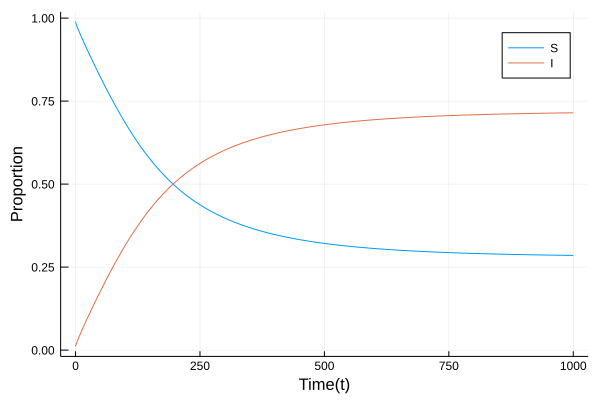

In [10]:
p1=Plots.plot(t1,sus,label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,inf,label="I")

In [231]:
function SIRS_configuration(x;α,β,γ,k_max,prop_deg)
    y = zeros(length(x))
    the_infected = x[1:k_max]
    the_susceptible = x[k_max+1:2*k_max]
    the_recovered = x[2*k_max+1:end]
    avg_k = collect(1:k_max) .* the_infected |> sum
    further = collect(1:k_max) .* prop_deg .* the_infected |> sum
    θ = further/avg_k
    for k in 1:k_max
        susceptible_k = α*the_recovered[k]
        infected_k = β*k*the_susceptible[k]*θ
        recovered_k = γ*the_infected[k]
        y[k] = infected_k - recovered_k
        y[k_max+k] = susceptible_k - infected_k
        y[2*k_max+k] = recovered_k - susceptible_k
    end
    y
end

SIRS_configuration (generic function with 1 method)

In [80]:
kmax = 100
infec = rand(kmax)
all = sum(infec)
prop_inf = infec/all;

In [96]:
pd = degree_dist(0.1,kmax)
sum(pd)

0.9999546000702378

What's the average degree?

In [97]:
pd .* collect(1:kmax) |> sum

10.503314874266593

In [98]:
the_proportions = vcat(prop_inf, 1 .- prop_inf, zeros(length(prop_inf)));

In [99]:
t1,y1 = my_integrator(0,2500,0.1,the_proportions;fun=SIRS_configuration,algo=heun,α = 0.0001, β=1,γ = 0.01,k_max=kmax,prop_deg=pd)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  2499.1, 2499.2, 2499.3, 2499.4, 2499.5, 2499.6, 2499.7, 2499.8, 2499.9, 2500.0], [0.00880014 0.00422662 … 0.0 0.0; 0.00893957 0.0045202 … 1.24323e-5 1.8712e-5; … ; 0.0100104 0.00966764 … 0.989622 0.989627; 0.0100103 0.00966764 … 0.989622 0.989627])

In [100]:
inf = sum(y1[:,1:kmax] .* pd',dims=2)
sus = sum(y1[:,kmax+1:2*kmax] .* pd',dims=2)
rec = sum(y1[:,2*kmax+1:end] .* pd',dims=2);

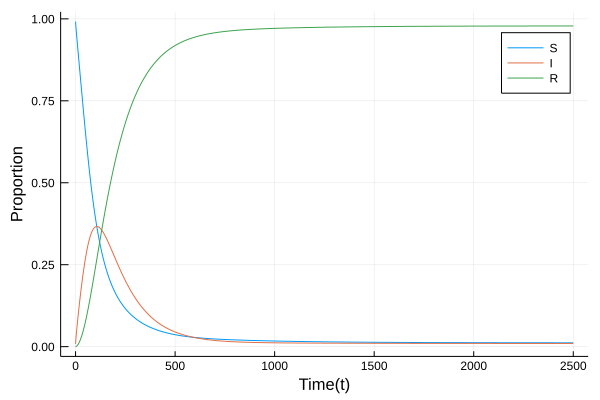

In [101]:
p1=Plots.plot(t1,sus,label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,inf,label="I")
Plots.plot!(t1,rec,label="R")

What if we change the degree distribution?

In [102]:
pd = degree_dist(0.4,kmax)
sum(pd)

0.9999999999999999

In [103]:
pd .* collect(1:kmax) |> sum

3.0332447817197354

In [104]:
t1,y1 = my_integrator(0,2500,0.1,the_proportions;fun=SIRS_configuration,algo=heun,α = 0.0001, β=1,γ = 0.01,k_max=kmax,prop_deg=pd)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  2499.1, 2499.2, 2499.3, 2499.4, 2499.5, 2499.6, 2499.7, 2499.8, 2499.9, 2500.0], [0.00880014 0.00422662 … 0.0 0.0; 0.0088265 0.00429304 … 5.40468e-6 1.1658e-5; … ; 0.00977427 0.00932664 … 0.988485 0.988502; 0.00977427 0.00932671 … 0.988485 0.988502])

In [105]:
inf = sum(y1[:,1:kmax] .* pd',dims=2)
sus = sum(y1[:,kmax+1:2*kmax] .* pd',dims=2)
rec = sum(y1[:,2*kmax+1:end] .* pd',dims=2);

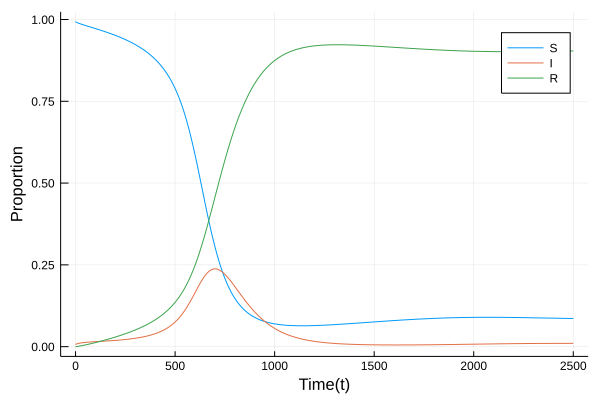

In [106]:
p1=Plots.plot(t1,sus,label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,inf,label="I")
Plots.plot!(t1,rec,label="R")

In [241]:
pd = degree_dist(0.6,kmax)
t1,y1 = my_integrator(0,5000,0.1,the_proportions;fun=SIRS_configuration,algo=heun,α = 0.0001, β=1,γ = 0.01,k_max=kmax,prop_deg=pd)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  4999.1, 4999.2, 4999.3, 4999.4, 4999.5, 4999.6, 4999.7, 4999.8, 4999.9, 5000.0], [0.00880014 0.00422662 … 0.0 0.0; 0.00881398 0.00426788 … 4.68778e-6 1.09384e-5; … ; 0.00751902 0.00833052 … 0.98748 0.987506; 0.00751913 0.00833066 … 0.98748 0.987506])

In [242]:
inf = sum(y1[:,1:kmax] .* pd',dims=2)
sus = sum(y1[:,kmax+1:2*kmax] .* pd',dims=2)
rec = sum(y1[:,2*kmax+1:end] .* pd',dims=2);

In [243]:
p1=Plots.plot(t1,sus,label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,inf,label="I")
Plots.plot!(t1,rec,label="R")

# Now suppose we have an intervention, name vaccine,  that reduces the chance of getting infected.

## Let's say that we vaccine a percentage of the population with some distribution

# What about a vaccine that is 70% effective?

NOTE: It doesn't have to be a vaccine, it could be any intervention

In [137]:
function SIRSv_configuration(x;α,β,γ,k_max,prop_deg,prop_vaccine,ν)
    y = zeros(length(x))
    the_infected = x[1:k_max]
    the_susceptible = x[k_max+1:2*k_max]
    the_recovered = x[2*k_max+1:end]
    avg_k = collect(1:k_max) .* the_infected |> sum
    further = collect(1:k_max) .* prop_deg .* the_infected |> sum
    θ = further/avg_k
    for k in 1:k_max
        susceptible_k = α*the_recovered[k]
        infected_k = β*k*the_susceptible[k]*(1-prop_vaccine[k])*θ + (1-ν)*β*k*the_susceptible[k]*prop_vaccine[k]*θ
        recovered_k = γ*the_infected[k]
        y[k] = infected_k - recovered_k
        y[k_max+k] = susceptible_k - infected_k
        y[2*k_max+k] = recovered_k - susceptible_k
    end
    y
end

SIRSv_configuration (generic function with 1 method)

## What about 35% of the population?

In [318]:
prop_vaccine = repeat([0.35],kmax);
ν = 0.7

0.7

In [236]:
pd = degree_dist(0.6,kmax)
t1,y1 = my_integrator(0,5000,0.1,the_proportions;fun=SIRSv_configuration,algo=heun,α = 0.0001, β=1,γ = 0.01,k_max=kmax,prop_deg=pd,prop_vaccine=prop_vaccine,ν=ν)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  4999.1, 4999.2, 4999.3, 4999.4, 4999.5, 4999.6, 4999.7, 4999.8, 4999.9, 5000.0], [0.00880014 0.00422662 … 0.0 0.0; 0.00880868 0.00425722 … 4.39404e-6 1.06435e-5; … ; 0.00766789 0.00826162 … 0.986884 0.986915; 0.00766759 0.00826132 … 0.986884 0.986915])

In [238]:
inf_r = sum(y1[:,1:kmax] .* pd',dims=2)
sus_r = sum(y1[:,kmax+1:2*kmax] .* pd',dims=2)
rec_r = sum(y1[:,2*kmax+1:end] .* pd',dims=2);

In [239]:
p1=Plots.plot(t1,sus_r,label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,inf_r,label="I")
Plots.plot!(t1,rec_r,label="R")

# Let's do targeted immunization! 35% of the population, but the most connected 35%

In [161]:
percentage = 0.35

0.35

In [180]:
from_this = 0
a = kmax
for k in kmax:-1:1
    from_this += pd[k]
    if from_this >= percentage
        break
    end
    a = k
end

In [313]:
lack = percentage - sum(pd[a:end])
prop_incomplete = lack/pd[a-1]
prop_vaccine = vcat(repeat([0],a-2),prop_incomplete,ones(kmax-a+1));

In [314]:
pd = degree_dist(0.6,kmax)
t1,y1 = my_integrator(0,5000,0.1,the_proportions;fun=SIRSv_configuration,algo=heun,α = 0.0001, β=1,γ = 0.01,k_max=kmax,prop_deg=pd,prop_vaccine=prop_vaccine,ν=ν)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  4999.1, 4999.2, 4999.3, 4999.4, 4999.5, 4999.6, 4999.7, 4999.8, 4999.9, 5000.0], [0.00880014 0.00422662 … 0.0 0.0; 0.00881497 0.00426331 … 3.84851e-6 1.00959e-5; … ; 0.00412848 0.00499804 … 0.971609 0.9718; 0.00412874 0.00499838 … 0.971609 0.971801])

In [219]:
inf_t = sum(y1[:,1:kmax] .* pd',dims=2)
sus_t = sum(y1[:,kmax+1:2*kmax] .* pd',dims=2)
rec_t = sum(y1[:,2*kmax+1:end] .* pd',dims=2);

In [220]:
p1=Plots.plot(t1,sus_t,label="S",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,inf_t,label="I")
Plots.plot!(t1,rec_t,label="R")

# Immunization curves - random vs targeted

In [244]:
p1=Plots.plot(t1,inf,label="no intervention",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,inf_r,label="random")
Plots.plot!(t1,inf_t,label="targeted")

# What happens if the interventions happen at some time instead of the begining

In [322]:
y1[1000,:]

300-element Array{Float64,1}:
 0.006901021254411457
 0.00787911276365589 
 0.00341756601136349 
 0.004798987565531784
 0.010568815855074385
 0.012732206238211878
 0.008654128693215251
 0.011052488928432138
 0.013485340273880438
 0.013298507767339986
 0.01743581325836043 
 0.018364946711390762
 0.018166324470255915
 ⋮                   
 0.07616734506737216 
 0.07470056765729856 
 0.07243339131002766 
 0.0776449776419938  
 0.07997891439370268 
 0.07805093832725139 
 0.08105715339030961 
 0.08158038205940688 
 0.07294692809548185 
 0.07411652743874834 
 0.07561259016784452 
 0.0797626042387662  

In [333]:
function the_rest(time,initial)
    the_proportions = initial[time*10,:]
    t2,y2 = my_integrator(time,5000,0.1,the_proportions;fun=SIRSv_configuration,algo=heun,α = 0.0001, β=1,γ = 0.01,k_max=kmax,prop_deg=pd,prop_vaccine=prop_vaccine,ν=ν)
    vcat(initial[1:time*10,:],y2[:,:])
    #y2
end

the_rest (generic function with 1 method)

In [367]:
function the_rest_back(time,initial)
    the_proportions = initial[time*10,:]
    t2,y2 = my_integrator(time,5000,0.1,the_proportions;fun=SIRS_configuration,algo=heun,α = 0.0001, β=1,γ = 0.01,k_max=kmax,prop_deg=pd)
    vcat(initial[1:time*10,:],y2[:,:])
    #y2
end

the_rest_back (generic function with 1 method)

In [324]:
pd = degree_dist(0.6,kmax)
t1,y1 = my_integrator(0,5000,0.1,the_proportions;fun=SIRS_configuration,algo=heun,α = 0.0001, β=1,γ = 0.01,k_max=kmax,prop_deg=pd)

([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9  …  4999.1, 4999.2, 4999.3, 4999.4, 4999.5, 4999.6, 4999.7, 4999.8, 4999.9, 5000.0], [0.00880014 0.00422662 … 0.0 0.0; 0.00881398 0.00426788 … 4.68778e-6 1.09384e-5; … ; 0.00751902 0.00833052 … 0.98748 0.987506; 0.00751913 0.00833066 … 0.98748 0.987506])

In [336]:
y9

50001×300 Array{Float64,2}:
 0.00880014  0.00422662  0.000254196  0.00101941  …  0.0          0.0        
 0.00881398  0.00426788  0.000322442  0.00110965     4.68778e-6   1.09384e-5 
 0.00882552  0.00430449  0.000383678  0.00119055     1.14835e-5   2.39862e-5 
 0.00883537  0.0043377   0.000439785  0.00126462     2.01931e-5   3.89489e-5 
 0.00884392  0.00436828  0.000491923  0.0013334      3.06689e-5   5.5678e-5  
 0.00885142  0.00439675  0.00054087   0.00139793  …  4.27937e-5   7.40558e-5 
 0.00885806  0.00442346  0.000587178  0.00145895     5.64712e-5   9.39859e-5 
 0.00886397  0.0044487   0.000631254  0.00151699     7.16208e-5   0.000115387
 0.00886925  0.00447267  0.000673411  0.00157247     8.81737e-5   0.000138191
 0.00887399  0.00449553  0.000713891  0.00162572     0.00010607   0.000162336
 0.00887825  0.00451742  0.000752892  0.001677    …  0.000125257  0.000187771
 0.00888208  0.00453843  0.000790573  0.00172652     0.000145688  0.000214448
 0.00888553  0.00455865  0.000827068

In [350]:
y2 = the_rest(200,y1)
y3 = the_rest(800,y1)
# y4 = the_rest(300,y1)
# y5 = the_rest(400,y1)
# y6 = the_rest(500,y1)
y7 = the_rest(1000,y1)
y8 = the_rest(1200,y1);
y9 = the_rest(3000,y1);

In [351]:
inf_2 = sum(y2[:,1:kmax] .* pd',dims=2)
inf_3 = sum(y3[:,1:kmax] .* pd',dims=2)
inf_4 = sum(y4[:,1:kmax] .* pd',dims=2)
inf_5 = sum(y5[:,1:kmax] .* pd',dims=2)
inf_6 = sum(y6[:,1:kmax] .* pd',dims=2)
inf_7 = sum(y7[:,1:kmax] .* pd',dims=2)
inf_8 = sum(y8[:,1:kmax] .* pd',dims=2);
inf_9 = sum(y9[:,1:kmax] .* pd',dims=2);

In [352]:
p1=Plots.plot(t1,inf,label="no intervention",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,inf_2,label="200")
Plots.plot!(t1,inf_3,label="800")
# Plots.plot!(t1,inf_4,label="300")
# Plots.plot!(t1,inf_5,label="400")
# Plots.plot!(t1,inf_6,label="500")
Plots.plot!(t1,inf_7,label="1000")
Plots.plot!(t1,inf_8,label="1200")
Plots.plot!(t1,inf_9,label="3000")

# If targeted

In [357]:
lack = percentage - sum(pd[a:end])
prop_incomplete = lack/pd[a-1]
prop_vaccine = vcat(repeat([0],a-2),prop_incomplete,ones(kmax-a+1));

In [371]:
# y2 = the_rest(100,y1)
# y3 = the_rest(200,y1)
# y4 = the_rest(300,y1)
# y5 = the_rest(400,y1)
# y6 = the_rest(500,y1)
# y7 = the_rest(1000,y1)
# y8 = the_rest(2000,y1);
# y9 = the_rest(3000,y1);
y2 = the_rest(200,y1)
y3 = the_rest(800,y1)
# y4 = the_rest(300,y1)
# y5 = the_rest(400,y1)
# y6 = the_rest(500,y1)
y7 = the_rest(1000,y1)
# y8 = the_rest(1200,y1);
# y9 = the_rest(3000,y1);
y10 = the_rest_back(1600,y3);

In [372]:
inf_2 = sum(y2[:,1:kmax] .* pd',dims=2)
inf_3 = sum(y3[:,1:kmax] .* pd',dims=2)
# inf_4 = sum(y4[:,1:kmax] .* pd',dims=2)
# inf_5 = sum(y5[:,1:kmax] .* pd',dims=2)
# inf_6 = sum(y6[:,1:kmax] .* pd',dims=2)
inf_7 = sum(y7[:,1:kmax] .* pd',dims=2);
# inf_8 = sum(y8[:,1:kmax] .* pd',dims=2);
# inf_9 = sum(y9[:,1:kmax] .* pd',dims=2);
inf_10 = sum(y10[:,1:kmax] .* pd', dims=2);

In [373]:
# p1=Plots.plot(t1,inf,label="no intervention",xaxis="Time(t)",yaxis="Proportion")
# Plots.plot!(t1,inf_2,label="100")
# Plots.plot!(t1,inf_3,label="200")
# Plots.plot!(t1,inf_4,label="300")
# Plots.plot!(t1,inf_5,label="400")
# Plots.plot!(t1,inf_6,label="500")
# Plots.plot!(t1,inf_7,label="1000")
# Plots.plot!(t1,inf_8,label="2000")
# Plots.plot!(t1,inf_9,label="3000")
p1=Plots.plot(t1,inf,label="no intervention",xaxis="Time(t)",yaxis="Proportion")
Plots.plot!(t1,inf_2,label="200")
Plots.plot!(t1,inf_3,label="800")
# Plots.plot!(t1,inf_4,label="300")
# Plots.plot!(t1,inf_5,label="400")
# Plots.plot!(t1,inf_6,label="500")
Plots.plot!(t1,inf_7,label="1000")
# Plots.plot!(t1,inf_8,label="1200")
# Plots.plot!(t1,inf_9,label="3000")
Plots.plot!(t1,inf_10,label="return")

# Please don't mind what's next, I want to get back to those ideas and I haven't backed that up

##### Heterogeneous mean-field (configuration model)

In [1809]:
function SIS_configuration(x;α,β,k_max,prop_deg)
    y = Array{Any}(undef,length(x))
    sus = Array{Float64}(undef,k_max)
    inf_k = Array{Float64}(undef,k_max)
    prop_inf = x
#     prop_inf = filter(f ->  isa(f,Tuple),x)[1] |> collect
#     x = filter(f ->  !isa(f,Tuple),x)
    avg_k = collect(1:k_max) .* prop_deg |> sum
    further = collect(1:k_max) .* prop_inf |> sum
    θ = further/avg_k
    for k in 1:k_max
#         θ = sum((collect(1:k_max) .- 1)*prop_deg[k]*prop_inf[k])/(sum(collect(1:k_max) .* prop_deg))
        infected_k = β*k*(1-prop_inf[k])*θ - α*prop_inf[k]
#         println(infected_k)
        susceptible_k = α*prop_inf[k]
#         println(susceptible_k)
        inf_k[k] = infected_k - susceptible_k
        sus[k] = -infected_k + susceptible_k
    end
#     y[1] = sum(sus)
#     y[2] = sum(inf_k)
#     pr_new = [1-inf_k[i] for i in eachindex(inf_k)]
    pr_new = inf_k
#     pr_new = pr_new/sum(pr_new)
#     println(inf_k/y[2])
#     y = vcat(y,tuple(inf_k/(y[1]+y[2])...,))
#     y = vcat(y,tuple(pr_new...))
    y = pr_new
    y
end


SIS_configuration (generic function with 1 method)

In [910]:
"""
    my_integrator(ti,tf,h,y0;fun,algo,kwargs...)
Integrates a function fun from ti to tf with step h and initial condition
y0 with algorithm algo.
"""
function my_integrator2(ti,tf,h,y0;fun=lv,algo=euler,kwargs...)
    t = ti:h:tf |> collect
    y = Array{Any}(undef,length(t),length(y0))
    y[1,:] .= y0
    for i ∈ 2:size(y)[1]
        value = algo(y[i-1,:],h;fun=fun,kwargs...)
        value2 = filter(f ->  !isa(f,Tuple),value)
        if any(@. !isless(value2,1e4))
            y = y[1:i-1,:]
            t = t[1:size(y)[1]]
            break
        end

        y[i,:] .= value

    end
    t,y
end

my_integrator2

In [809]:
f = SIS_configuration(vcat(0.7,0.3,prop_inf);α=0.1,β=0.6,k_max=kmax,prop_deg=pd)
#@. vcat(0.7,0.3,prop_inf) + f #* 0.1

3-element Array{Any,1}:
 -0.7790540940493849                                                                                                                                                                                                 
  0.7790540940493849                                                                                                                                                                                                 
   (0.5500916598497194, 0.6929929999535323, 0.5059045676792011, 0.32314706091615614, 0.09006711117393915, -0.12652135260089545, -0.1037494929266384, -0.4027714923601793, -0.45472285874901985, -0.07443820293581528)

In [1514]:
function euler2(x,h;fun=lv,kwargs...)
    try
        f = fun(x;kwargs...)
        x1 = filter(f ->  !isa(f,Tuple),x)
        x2 = filter(f ->  isa(f,Tuple),x)[1] |> collect
        x = vcat(x1,x2)
        f1 = filter(i ->  !isa(i,Tuple),f)
        f2 = filter(i ->  isa(i,Tuple),f)[1] |> collect
        f = vcat(f1,f2)
        y = x .+ (f * h)
        y1 = y[1:2]
#         y2 = y[3:end]/sum(y[3:end])
        y2 = y[3:end]
        y2 = Tuple(y2)
        y3 = vcat(y1,y2)
        return y3
    catch
        return @. x + fun(x;kwargs...) * h
    end
end

euler2 (generic function with 1 method)

In [1513]:
"""
    heun(x,h;fun,kwargs...)
Uses Heun method to integrate function fun at x with step h
"""
function heun2(x,h;fun=lv,kwargs...)
    try
        y1 = euler2(x,h;fun=fun,kwargs...)
        first = fun(x;kwargs...) |> Iterators.flatten |> collect
        second = fun(y1;kwargs...) |> Iterators.flatten |> collect
        y2 = first .+ second
        x = x |> Iterators.flatten |> collect
        yf = x .+ h * 0.5 * y2
        y1 = yf[1:2]
#         y2 = yf[3:end]/sum(yf[3:end])
        y2 = yf[3:end]
        y2 = Tuple(y2)
        y3 = vcat(y1,y2)
        return y3
    catch
        y1 = euler(x,h;fun=fun,kwargs...)
        y2 = @. fun(x;kwargs...) + fun(y1;kwargs...)
        yf = @. x + h * 0.5 * y2
        return yf
    end
end

heun2

In [1156]:
asdf = heun2(vcat(0.7,0.3,prop_inf),0.1;fun=SIS_configuration,α=0.1,β=0.6,k_max=kmax,prop_deg=pd)

3-element Array{Any,1}:
 -1153.3979834537586                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            

In [437]:
Tuple.(eachrow(y4[:,3:end]))

1001-element Array{Tuple{Float64,Float64,Float64},1}:
 (0.6662514334235119, 0.8663260270303643, 0.05165125600836995)   
 (0.2845887872694042, 0.8455913118532625, 0.33220285312722586)   
 (0.27607562376961514, 0.6727857010054534, 0.2012197266544069)   
 (0.10959694222698957, 0.5958150791073675, 0.06612428561744865)  
 (0.722708797738898, 0.27725426642202566, 0.9778613742826965)    
 (0.2494948679505471, 0.6419812886807215, 0.3662076169811177)    
 (0.42825230160150674, 0.7666281749744217, 0.9496624847464779)   
 (0.16697772872926286, 0.6562463554856879, 0.8808471556399635)   
 (0.23311537779543245, 0.6896546199415516, 0.8363112050185149)   
 (0.6606096700383086, 0.610883548093289, 0.4612075146031771)     
 (0.4590064375046896, 0.19542715244736675, 0.8601100150143615)   
 (0.46626866889152474, 0.016271141309123438, 0.5679590562613488) 
 (0.9610570029886245, 0.8375431770012458, 0.5770563918174476)    
 ⋮                                                               
 (0.6490902429029961, 